# Procesamiento de Voz
# Proyecto N° 1 - Time stretching de una señal de audio para beatmatching
* Matías Francois
* Joaquín Gaytan

# TODO
* Agregar lo de LP-PSOLA del paper
* Agregar análisis de canción
* ¿para qué usaría LPC en canciones si justamente no tengo un modelo de producción? -> leer paper.

## Notebook #1: Análisis de LPC
Los predictores lineales son ampliamente utilizados en codificación de voz, dado que son eficaces a la hora de modelar el aparato de fonación. Esto permite lograr compresión en pistas de voz. En este notebook se busca analizar la conveniencia del algoritmo LPC (*linear predivtive coding*) a la hora de realizar un time stretching de una señal de audio, a través de variantes del algoritmo PSOLA. Este algoritmo es síncrono respecto del pitch, lo que significa que para poder variar la duración de una canción se necesitan las anotaciones de pitch.

El pitch se define como la frecuencia fundamental en una determinada ventana, dentro de la cual se puede considerar que permanece constante. En voz sonora, la frecuencia fundamental está determinada exclusivamente por los pulsos glotales. Es por esto que, a la hora de incorporar un algoritmo de detección de pitch que genere las anotaciones, es conveniente preprocesar a la señal de audio para lograr mejores resultados. Es así como en el caso de señales de voz, se puede aplicar el filtro del error de predicción $A(z)$ para obtener la señal de pulsos glotales.

$$A(z) = 1 - P(z) $$

En donde $P(z)$ es el filtro predictor de la señal.

In [1]:
import librosa
import numpy as np
import matplotlib.pyplot as plt
import scipy.signal as sps
import soundfile as sf
from IPython.display import Audio
from modified_psola import modified_psola
from detect_pitch import get_fundamental_frequency
from helpers.helper import *

### Loading sample files
Se analizan dos casos: una pista de audio que contiene un discurso, y una canción solo contiene una melodía.

In [2]:
# Importing sample songs
song_filename = 'starwars.wav'
#speech_filename = 'female_scale.wav'
speech_filename = 'speech.wav'

song_samples, song_fs =librosa.load('./samples/' + song_filename)
speech_samples, speech_fs = librosa.load('./samples/' + speech_filename)

## LPC test for speech
En este paso, se aplica un LPC de orden 12 a la señal de voz, de forma tal de recuperar tanto el filtro que representa el aparato fonador, como el filtro del error de predicción y el error asociado. En principio, este filtro se aplica sobre toda la señal a la vez.

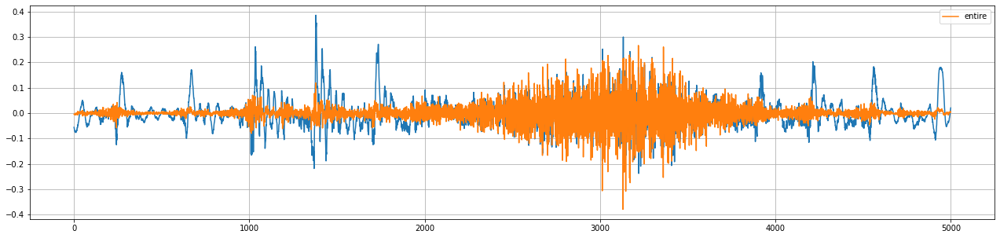

In [3]:
# Using order 12 filter to modelate voice production
lpc_speech_order = 12

# Getting LPC error filter coefficients
speech_coefs, speech_error = LPC_process(speech_samples, speech_fs, lpc_speech_order)

# Print error
plt.figure(figsize=(22,5))
plt.plot(speech_samples[2*speech_fs:2*speech_fs+5000])
plt.plot(speech_error.flatten()[2*speech_fs:2*speech_fs+5000], label='entire')
#plt.plot(_speech_error.flatten(), label='entire')
plt.grid(which='both', axis='both')
plt.legend()
plt.show()

In [4]:
# Rebuild signal using LPC filter
rebuilt_speech = LPC_rebuild(speech_error, speech_coefs)

# Save signal
sf.write(f'rebuilt_speech_LPC_order_{lpc_speech_order}.wav', rebuilt_speech, speech_fs)

# Play signal
Audio(f'rebuilt_speech_LPC_order_{lpc_speech_order}.wav')

### Plain PSOLA
Aquí se aplica el algoritmo PSOLA sin la intervención del filtro predictor, para tener una referencia con qué comparar los siguientes resultados. Este procesamiento altera tanto el pitch como la duración de la pista. Luego, se detectan los picos (anotaciones de pitch) sobre la secuencia de muestras original.

In [5]:
# Time stretching factor
time_factor = 0.85

# PSOLA Algorithm
speech_psola = psola(speech_samples, get_periods(speech_samples), time_factor)

# Save signal
sf.write(f'speech_psola_x{time_factor}.wav', speech_psola, speech_fs)

# Play audio
Audio(f'speech_psola_x{time_factor}.wav')

### PSOLA using LPC error to detect peaks
En este punto se cambia la señal de referencia para la detección de picos por la señal de error del filtro predictor, por lo que se debería obtener una medición más precisa del pitch en cada una de las zonas.

In [6]:
# PSOLA Algorithm with LPC error peak detection
speech_psola_LPC_peaks = psola(speech_samples, get_periods(speech_error), time_factor)

# Save signal
sf.write(f'speech_psola_LPC_peak_x{time_factor}.wav', speech_psola_LPC_peaks, speech_fs)

# Play audio
Audio(f'speech_psola_LPC_peak_x{time_factor}.wav')

### PSOLA on LPC error signal (LP-PSOLA)
Si se integra totalemnte el predictor lineal en el algoritmo PSOLA, se obtiene una nueva variante del algoritmo denominada LP-PSOLA. Este algoritmo se caracteriza por realizar un cambio de dominio en la aplicación del algoritmo PSOLA, el cual se aplica directamente sobre la señal del error de predicción. Luego, se aplica el inverso del filtro del error de predicción y se obtiene la pista con la duración y pitch modificados.

In [7]:
# PSOLA Algorithm on LPC error
speech_error_psola = psola(speech_error, get_periods(speech_error), time_factor)

# Regenerating signal from LPC error
speech_psola_rebuilt =  LPC_rebuild(speech_error_psola, speech_coefs)

# Save signal
sf.write(f'speech_psola_rebuilt_x{time_factor}.wav', speech_psola_rebuilt, speech_fs)

# Play audio
Audio(f'speech_psola_rebuilt_x{time_factor}.wav')

## LPC test for a song
En esta parte se tratará de aplicar lo hecho para señales de voz, para una señal de audio. En principio, se discute el uso de LPC en los casos en los que no predomina la voz por dos razones distintas:
* **Variabilidad**: A diferencia de las señales de voz, en donde en general el modelo de producción es conocido y consistente para toda persona hablante, en el caso de la música existen muchas fuentes de sonido distintas: instrumentos de percusión, de viento, de cuerdas, sintetizadores, etc. Esto hace que identificar y modelar cada una de estas fuentes sea una tarea compleja, con lo cual se torna imposible lograr un modelo genérico que aplique para cualquier canción.

* **Composición espectral**: Como se indica en el artículo *Comparison of Linear Prediction Models for Audio Signals* (Toon van Waterschoot, Marc Moonen - 2009), las canciones se destacan por concentrar su contenido espectral en una zona pequeña del espectro de Nyquist, especialmente en comparación con las señales de voz, en donde generalmente se tiene una tasa de muestreo menor (y por ende, un menor ancho de banda) y una distribución mas equiativa de la potencia. Luego, esta característica propia de las canciones hace que la matriz de autocorrelación exhiba un autovalor alto, lo que conlleva una inestabilidad numérica, produciendo modelos de predicción inexactos.

Estas dos características hacen que se deba modificar al predictor para lograr un funcionamiento óptimo.

### Plain PSOLA

In [12]:
# Time stretching factor
song_time_factor = 0.85

# PSOLA Algorithm
song_psola = psola(song_samples, get_periods(song_samples), song_time_factor)

# Save signal
sf.write(f'song_psola_x{time_factor}.wav', song_psola, song_fs)

# Play audio
Audio(f'song_psola_x{time_factor}.wav')

### PSOLA using LPC error to detect peaks

In [14]:
# Using order 12 filter to modelate voice production
lpc_song_order = 12

# Getting LPC error filter coefficients
song_coefs, song_error = LPC_process(song_samples, song_fs, lpc_song_order)

# PSOLA Algorithm with LPC error peak detection
song_psola_LPC_peaks = psola(song_samples, get_periods(song_error), song_time_factor)

# Save signal
sf.write(f'song_psola_LPC_peak_x{time_factor}.wav', song_psola_LPC_peaks, song_fs)

# Play audio
Audio(f'song_psola_LPC_peak_x{time_factor}.wav')

### PSOLA on LPC error signal (LP-PSOLA)

In [15]:
song_error_psola = psola(song_error, get_periods(song_error), song_time_factor)

# Regenerating signal from LPC error
song_psola_rebuilt =  LPC_rebuild(song_error_psola, song_coefs)

# Save signal
sf.write(f'song_psola_rebuilt_x{time_factor}.wav', song_psola_rebuilt, song_fs)

# Play audio
Audio(f'song_psola_rebuilt_x{time_factor}.wav')

### PSOLA on short-time LPC error signal

In [9]:
# Short-time LPC on 20ms window
speech_coefs_st, speech_error_st = LPC_process(speech_samples, speech_fs, lpc_speech_order, 500)

frame_len = len(speech_error_st[0])

# Apply PSOLA to the joined error signal
speech_error_stretched = psola(speech_error_st.flatten(), get_periods(speech_error_st.flatten()), time_factor)

# Group
speech_error_stretched = np.array([[speech_error_stretched[i+j] for j in range(frame_len)] for i in range(len(speech_error_st))])

# Retransform and add
new_signal_st = np.array([LPC_rebuild(speech_error_stretched[i], speech_coefs_st[i]) for i in range(len(speech_error_st))]).flatten()

# Save signal
sf.write(f'speech_psola_rebuilt_x{time_factor}_st.wav', new_signal_st, speech_fs)

# Play audio
Audio(f'speech_psola_rebuilt_x{time_factor}_st.wav')

11025


# Modified PSOLA testing

In [10]:
################
ourLPC = False  #
################

T = 20*1e-3
samples = int(T * speech_fs)
L = samples//4
K = L

if ourLPC == True:
    a, e_ = LPC_process(speech_samples, speech_fs, 12)
    
else:
    a = librosa.lpc(speech_samples, order=12)
    e_ = sps.lfilter(a,[1], speech_samples) # obtenemos la senial error a traves del filtrado

f0,sample_f0 = get_fundamental_frequency(e_,K,L,speech_fs)

print("Frecuencia fundamental : ",f0," ", sample_f0)
speed = 1.1
error_audio = modified_psola(e_,sample_f0, speed)

if ourLPC == True:
    new_audio = LPC_rebuild(error_audio, a)
    
else:
    new_audio = sps.lfilter([1],a, error_audio)
    
sf.write("modified_psola_lpc.wav", new_audio, speech_fs)

Audio("modified_psola_lpc.wav")

D:\Users\Joaco\Desktop\repos\Voz\Beatmatching\LPC\detect_pitch.py:69: RuntimeWarning: divide by zero encountered in longlong_scalars
  min_f = fs/min_f_sample # fs / Muestras = f0_hat


Frecuencia fundamental :  135.48510403375656   164


# Modified PSOLA without LPC

In [11]:
T = 20*1e-3
samples = int(T * speech_fs)
L = samples//4
K = L

f0,sample_f0 = get_fundamental_frequency(speech_samples, K, L, speech_fs)

print("Frecuencia fundamental : ", f0, " ", sample_f0)
speed = 1.1
new_audio = modified_psola(speech_samples, sample_f0, speed)
    
sf.write("modified_psola.wav", new_audio, speech_fs)

Audio("modified_psola.wav")

Frecuencia fundamental :  135.65792032257636   164
